# First, extract the masks from the different phases

In [1]:
import torch.nn as nn
import torch
import os
import torch as t
import numpy as np
import torch.optim as optim
import time
import torch.nn.functional as F
import einops
import random
import copy
from pathlib import Path
from dataclasses import dataclass

In [2]:
from transformers_mod import train_model, Config, Transformer

In [3]:
%load_ext autoreload
%autoreload 2

In [4]:
high_level_root = Path(os.getcwd())
large_file_root = high_level_root/'large_files'
full_run_data = torch.load(large_file_root/'grokking_addition_full_run.pth', map_location=torch.device('cpu'))
print(full_run_data.keys())
print(full_run_data['config'])

dict_keys(['train_losses', 'test_losses', 'epochs', 'state_dicts', 'model', 'config'])
{'lr': 0.001, 'p': 113, 'd_model': 128, 'fn_name': 'add', 'frac_train': 0.3, 'num_epochs': 50000, 'save_models': True, 'save_every': 100, 'stopping_thresh': 1e-10, 'seed': 0, 'weight_decay': 1}


In [5]:
root = high_level_root/'expt_files'

In [8]:
config = Config()

In [9]:
class Pruner:
    def __init__(self, masked_parameters):
        self.masked_parameters = list(masked_parameters)
        self.scores = {}

    def score(self, model, loss, dataloader, device):
        raise NotImplementedError

    def _global_mask(self, sparsity):
        r"""Updates masks of model with scores by sparsity level globally."""
        # # Set score for masked parameters to -inf
        # for mask, param in self.masked_parameters:
        #     score = self.scores[id(param)]
        #     score[mask == 0.0] = -np.inf

        # Threshold scores
        global_scores = torch.cat([torch.flatten(v) for v in self.scores.values()])
        k = int((1.0 - sparsity) * global_scores.numel())
        if not k < 1:
            threshold, _ = torch.kthvalue(global_scores, k)
            for mask, param in self.masked_parameters:
                score = self.scores[id(param)]
                zero = torch.tensor([0.0]).to(mask.device)
                one = torch.tensor([1.0]).to(mask.device)
                # print(f'score shape {score.shape}')
                # print(f'mask shape {mask.shape}')
                mask.copy_(torch.where(score <= threshold, zero, one))

    def _local_mask(self, sparsity):
        r"""Updates masks of model with scores by sparsity level parameter-wise."""
        for mask, param in self.masked_parameters:
            score = self.scores[id(param)]
            k = int((1.0 - sparsity) * score.numel())
            if not k < 1:
                threshold, _ = torch.kthvalue(torch.flatten(score), k)
                zero = torch.tensor([0.0]).to(mask.device)
                one = torch.tensor([1.0]).to(mask.device)
                mask.copy_(torch.where(score <= threshold, zero, one))

    def mask(self, sparsity, scope):
        r"""Updates masks of model with scores by sparsity according to scope."""
        if scope == "global":
            self._global_mask(sparsity)
        if scope == "local":
            self._local_mask(sparsity)

    @torch.no_grad()
    def apply_mask(self):
        r"""Applies mask to prunable parameters."""
        for mask, param in self.masked_parameters:
            param.mul_(mask)

    def alpha_mask(self, alpha):
        r"""Set all masks to alpha in model."""
        for mask, _ in self.masked_parameters:
            mask.fill_(alpha)

    # Based on https://github.com/facebookresearch/open_lth/blob/master/utils/tensor_utils.py#L43
    def shuffle(self):
        for mask, param in self.masked_parameters:
            shape = mask.shape
            perm = torch.randperm(mask.nelement())
            mask = mask.reshape(-1)[perm].reshape(shape)

    def invert(self):
        for v in self.scores.values():
            v.div_(v**2)

    def stats(self):
        r"""Returns remaining and total number of prunable parameters."""
        remaining_params, total_params = 0, 0
        for mask, _ in self.masked_parameters:
            remaining_params += mask.detach().cpu().numpy().sum()
            total_params += mask.numel()
        return remaining_params, total_params

class Mag(Pruner):
    def __init__(self, masked_parameters):
        super(Mag, self).__init__(masked_parameters)

    def score(self, model, loss, dataloader, device):
        for _, p in self.masked_parameters:
            self.scores[id(p)] = torch.clone(p.data).detach().abs_()

In [10]:
def masks(module):
    r"""Returns an iterator over modules masks, yielding the mask."""
    for name, buf in module.named_buffers():
        if "weight_mask" in name:
            yield buf


# def parameters(model):
#     r"""Returns an iterator over models trainable parameters, yielding just the
#     parameter tensor.
#     """
#     for module in model.modules():
#         for param in module.parameters(recurse=False):
#             yield param


def masked_parameters(model):
    r"""Returns an iterator over models prunable parameters, yielding both the
    mask and parameter tensors.
    """
    for module in model.modules():
        for mask, param in zip(masks(module), module.parameters(recurse=False)):
            yield mask, param

In [11]:
sparsity = 0.4
scope = "global"

In [12]:
phase_epoch = [1400, 9400, 14000]
phase_names = ['memorization', 'circuit_formation', 'cleanup']

wandb: Currently logged in as: nc0. Use `wandb login --relogin` to force relogin


training length =  3830
testing length =  8939
Run name memorization_1699560674
Epoch 0, train loss 1.5526, test loss 1.5590
Saved epoch to wandb
Saved model to saved_runs_ticket/memorization_1699560674/0.pth
taking metrics
Logged metrics to wandb
Epoch 100, train loss 1.1302, test loss 1.8464
Saved epoch to wandb
Saved model to saved_runs_ticket/memorization_1699560674/100.pth
Epoch 200, train loss -3.0002, test loss 2.5782
Saved epoch to wandb
Saved model to saved_runs_ticket/memorization_1699560674/200.pth
Epoch 300, train loss -4.3791, test loss 2.6460
Saved epoch to wandb
Saved model to saved_runs_ticket/memorization_1699560674/300.pth
Epoch 400, train loss -5.5011, test loss 2.7010
Saved epoch to wandb
Saved model to saved_runs_ticket/memorization_1699560674/400.pth
Epoch 500, train loss -6.5886, test loss 2.7540
Saved epoch to wandb
Saved model to saved_runs_ticket/memorization_1699560674/500.pth
Epoch 600, train loss -7.6540, test loss 2.8055
Saved epoch to wandb
Saved model to

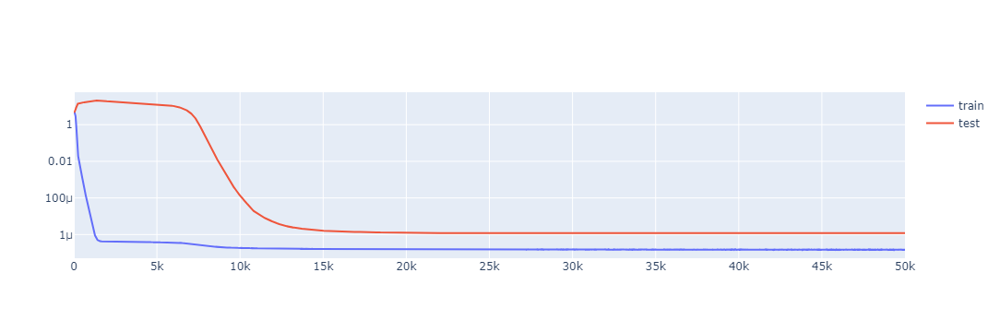

epoch,▁▁▁▂▂▂▂▂▂▃▃▃▃▃▄▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
test_loss,▆█▇▆▅▄▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
train_loss,█▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
trig_loss,█▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
epoch,50000
test_loss,0.0
train_loss,0.0
trig_loss,0.0


training length =  3830
testing length =  8939
Run name circuit_formation_1699564024
Epoch 0, train loss 1.5558, test loss 1.5574
Saved epoch to wandb
Saved model to saved_runs_ticket/circuit_formation_1699564024/0.pth
taking metrics


wandb: Network error (ConnectionError), entering retry loop.
wandb: Network error (ConnectionError), entering retry loop.


Logged metrics to wandb
Epoch 100, train loss 1.3682, test loss 1.7344
Saved epoch to wandb
Saved model to saved_runs_ticket/circuit_formation_1699564024/100.pth
Epoch 200, train loss -2.3162, test loss 0.6034
Saved epoch to wandb
Saved model to saved_runs_ticket/circuit_formation_1699564024/200.pth
Epoch 300, train loss -4.3492, test loss 0.2709
Saved epoch to wandb
Saved model to saved_runs_ticket/circuit_formation_1699564024/300.pth
Epoch 400, train loss -5.5198, test loss 0.0201
Saved epoch to wandb
Saved model to saved_runs_ticket/circuit_formation_1699564024/400.pth
Epoch 500, train loss -6.6474, test loss -0.1944
Saved epoch to wandb
Saved model to saved_runs_ticket/circuit_formation_1699564024/500.pth
Epoch 600, train loss -7.7569, test loss -0.3673
Saved epoch to wandb
Saved model to saved_runs_ticket/circuit_formation_1699564024/600.pth
Epoch 700, train loss -8.8652, test loss -0.5572
Saved epoch to wandb
Saved model to saved_runs_ticket/circuit_formation_1699564024/700.pth
E

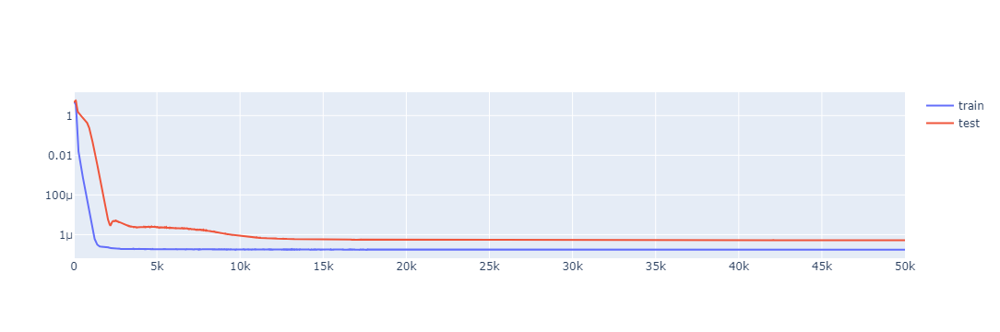

epoch,▁▁▁▂▂▂▂▂▂▃▃▃▃▃▄▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
test_loss,█▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
train_loss,█▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
trig_loss,█▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
epoch,50000
test_loss,0.0
train_loss,0.0
trig_loss,0.0


training length =  3830
testing length =  8939
Run name cleanup_1699567342
Epoch 0, train loss 1.5569, test loss 1.5571
Saved epoch to wandb
Saved model to saved_runs_ticket/cleanup_1699567342/0.pth
taking metrics
Logged metrics to wandb
Epoch 100, train loss 1.4038, test loss 1.7336
Saved epoch to wandb
Saved model to saved_runs_ticket/cleanup_1699567342/100.pth
Epoch 200, train loss -1.6991, test loss 0.7661
Saved epoch to wandb
Saved model to saved_runs_ticket/cleanup_1699567342/200.pth
Epoch 300, train loss -4.3935, test loss 0.3447
Saved epoch to wandb
Saved model to saved_runs_ticket/cleanup_1699567342/300.pth
Epoch 400, train loss -5.6743, test loss 0.0055
Saved epoch to wandb
Saved model to saved_runs_ticket/cleanup_1699567342/400.pth
Epoch 500, train loss -6.9989, test loss -0.5397
Saved epoch to wandb
Saved model to saved_runs_ticket/cleanup_1699567342/500.pth
Epoch 600, train loss -8.2952, test loss -1.5079
Saved epoch to wandb
Saved model to saved_runs_ticket/cleanup_169956

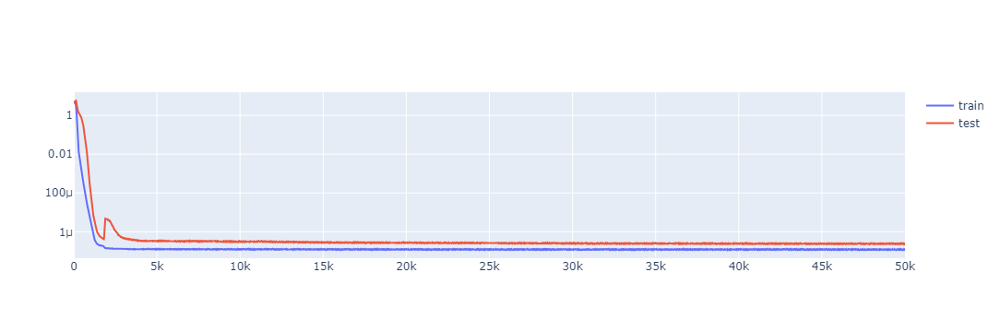

In [13]:
for epoch, phase_name in zip(phase_epoch, phase_names):
    pruner_model = Transformer(config=config, use_cache=False, use_ln=config.use_ln)
    pruner_model.load_state_dict(full_run_data['state_dicts'][full_run_data['epochs'].index(epoch)], strict=False)
    pruner = Mag(masked_parameters(pruner_model))
    pruner.score(None, None, None, None)
    pruner.mask(sparsity, scope)
    # map mask to base model
    masked_model = copy.deepcopy(pruner_model)
    model = Transformer(config=config, use_cache=False, use_ln=config.use_ln)
    model.load_state_dict(full_run_data['state_dicts'][full_run_data['epochs'].index(0)], strict=False)
    
    for (n1, m1), (n2, m2) in zip(masked_model.named_buffers(), model.named_buffers()):
        m2.copy_(m1)
    world = train_model(config=config, model=model, run_name=phase_name)
    torch.cuda.empty_cache()